In [1]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
import os
%matplotlib inline     

In [2]:
base_folder = os.getcwd()
res_data = pd.read_csv(base_folder + "/data/zomato.csv")

In [3]:
# Removing some columns
res_data.drop(["url", "address", "phone"], axis=1, inplace=True)

# Changing some Column's Name
res_data.columns
res_data = res_data.rename(columns={'approx_cost(for two people)':'cost_for_two_people','listed_in(type)':'type',
                                  'listed_in(city)':'city'})

#Removing the Duplicates
res_data.duplicated().sum()
res_data.drop_duplicates(inplace=True)

In [4]:
#Remove the NaN values from the dataset
res_data.isnull().sum()
res_data.dropna(how='any',inplace=True)
#res_data.info()

In [5]:
# Some Transformations
res_data['cost_for_two_people'] = res_data['cost_for_two_people'].astype(str)
res_data['cost_for_two_people'] = res_data['cost_for_two_people'].apply(lambda x: x.replace(',','.'))
res_data['cost_for_two_people'] = res_data['cost_for_two_people'].astype(float)
#res_data.info()

In [6]:
# Excluding 'NEW' and '-'from Rates
res_data = res_data.loc[res_data.rate !='NEW']
res_data = res_data.loc[res_data.rate !='-'].reset_index(drop=True)
res_data.rate =  res_data.rate.apply(lambda x: x.replace('/5',''))
res_data.rate = res_data.rate.apply(lambda x: float(x))

In [7]:
res_data.rate.unique()

array([4.1, 3.8, 3.7, 4.6, 4. , 4.2, 3.9, 3. , 3.6, 2.8, 4.4, 3.1, 4.3,
       2.6, 3.3, 3.5, 3.2, 4.5, 2.5, 2.9, 3.4, 2.7, 4.7, 2.4, 2.2, 2.3,
       4.8, 4.9, 2.1, 2. , 1.8])

Index(['name', 'online_order', 'book_table', 'rate', 'votes', 'location',
       'rest_type', 'dish_liked', 'cuisines', 'cost_for_two_people',
       'reviews_list', 'menu_item', 'type', 'city'],
      dtype='object')

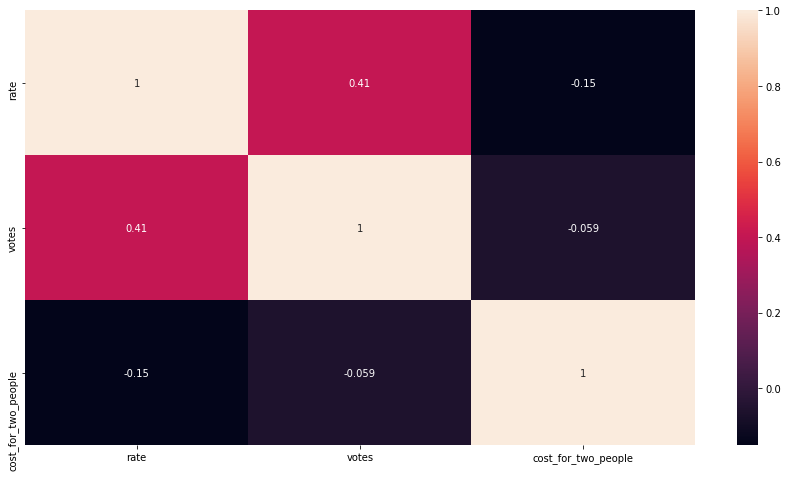

In [8]:
#Get Correlation between different variables
corr = res_data.corr(method='kendall')
plt.figure(figsize=(15,8))
sns.heatmap(corr, annot=True)
res_data.columns

Text(0, 0.5, 'Location in city')

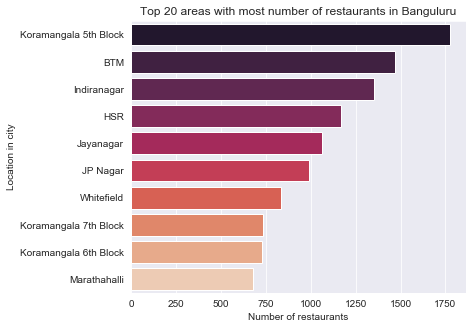

In [9]:
areas = res_data['location'].value_counts()[:10]

plt.figure(figsize=(6, 5))
sns.set_style('darkgrid')
sns.barplot(x=areas, y=areas.index, palette='rocket')
plt.title('Top 20 areas with most number of restaurants in Banguluru')
plt.xlabel('Number of restaurants')
plt.ylabel('Location in city')

Text(0, 0.5, 'Cuisines')

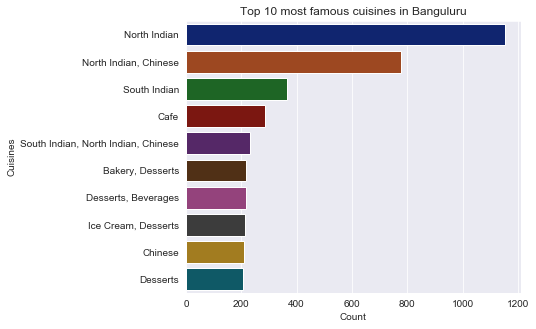

In [10]:
cuisines = res_data['cuisines'].value_counts()[:10]
plt.figure(figsize=(6,5))
sns.set_style('darkgrid')
sns.barplot(x= cuisines, y= cuisines.index, palette='dark')
plt.title('Top 10 most famous cuisines in Banguluru')
plt.xlabel('Count')
plt.ylabel('Cuisines')

Text(0, 0.5, 'Services')

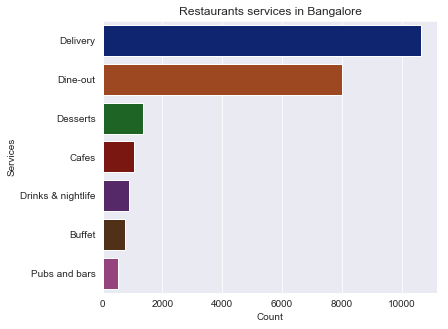

In [11]:
services = res_data['type'].value_counts()
plt.figure(figsize=(6,5))
sns.set_style('darkgrid')
sns.barplot(x=services, y=services.index, palette='dark')
plt.title('Restaurant''s services in Bangalore')
plt.xlabel('Count')
plt.ylabel('Services')

Text(0, 0.5, 'Types of restaurant')

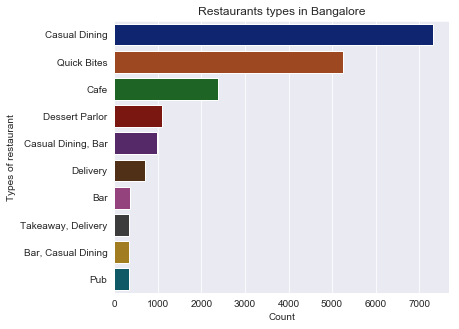

In [12]:
rest_type = res_data['rest_type'].value_counts()[:10]
plt.figure(figsize=(6,5))
sns.set_style('darkgrid')
sns.barplot(x=rest_type, y=rest_type.index, palette='dark')
plt.title('Restaurant''s types in Bangalore')
plt.xlabel('Count')
plt.ylabel('Types of restaurant')

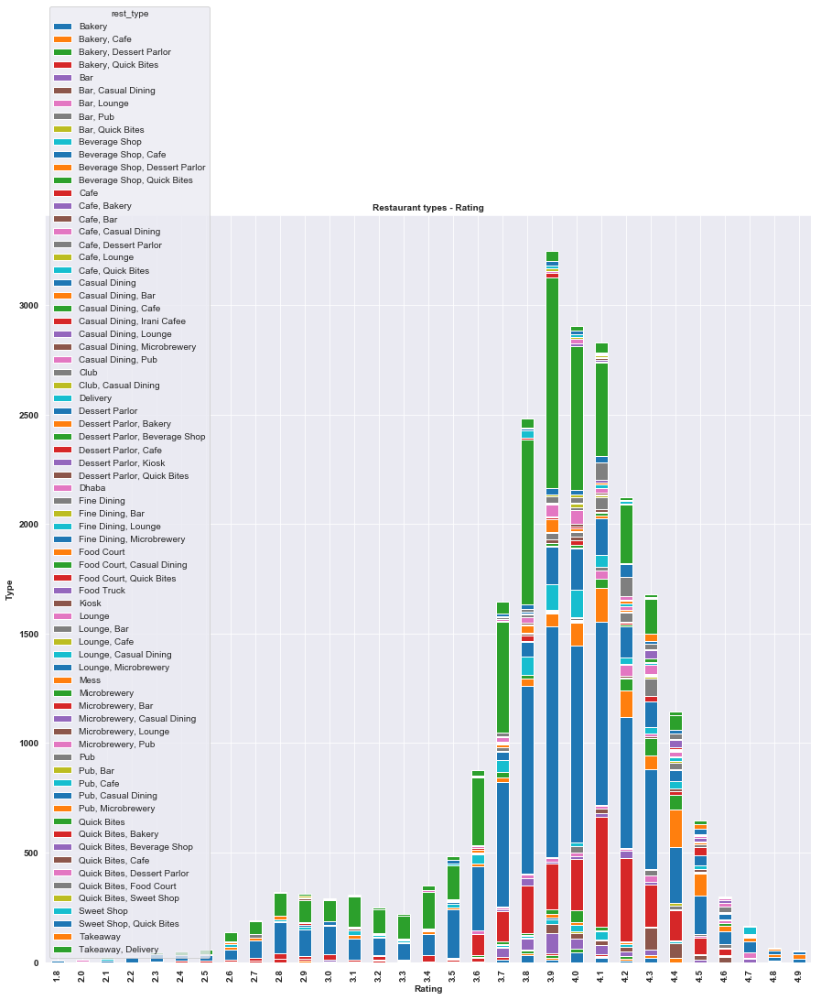

In [13]:
#Restaurant type and Rating
type_plt = pd.crosstab(res_data['rate'],res_data['rest_type'])
type_plt.plot(kind='bar',stacked=True, figsize=(15,15));
plt.title('Restaurant types - Rating',fontsize=10,fontweight='bold')
plt.ylabel('Type',fontsize=10,fontweight='bold')
plt.xlabel('Rating',fontsize=10,fontweight='bold')
plt.xticks(fontsize=10,fontweight='bold')
plt.yticks(fontsize=10,fontweight='bold');

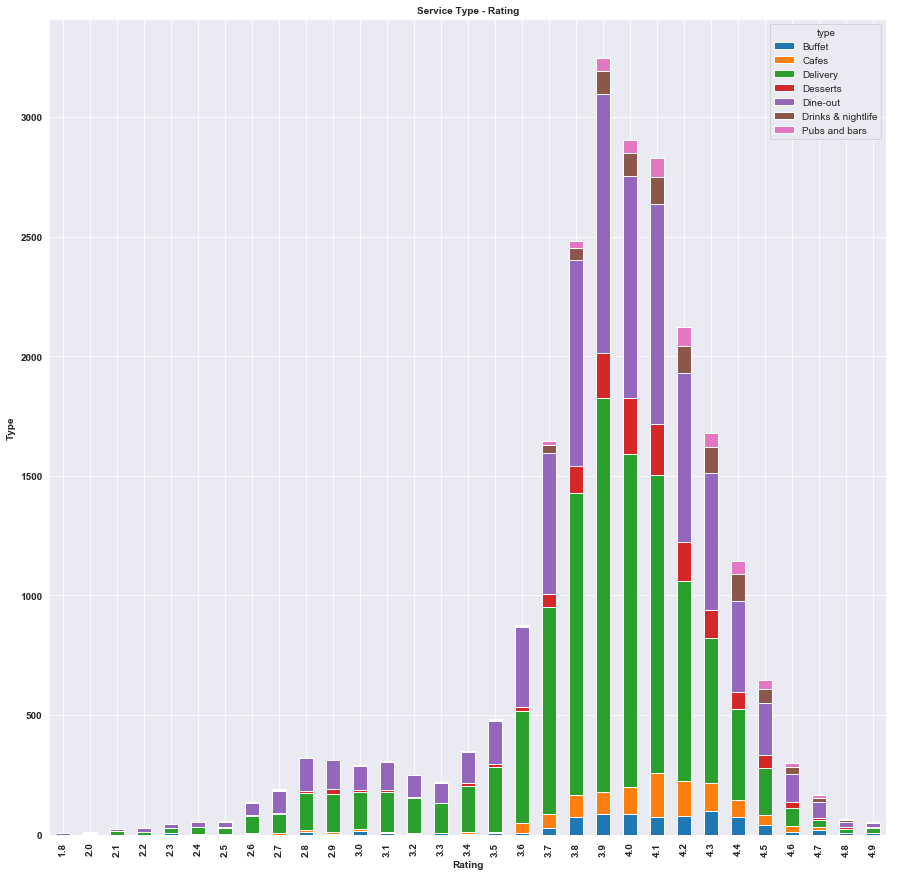

In [14]:
#Type and Rating
type_plt = pd.crosstab(res_data['rate'],res_data['type'])
type_plt.plot(kind='bar',stacked=True, figsize=(15,15));
plt.title('Service Type - Rating',fontsize=10,fontweight='bold')
plt.ylabel('Type',fontsize=10,fontweight='bold')
plt.xlabel('Rating',fontsize=10,fontweight='bold')
plt.xticks(fontsize=10,fontweight='bold')
plt.yticks(fontsize=10,fontweight='bold');

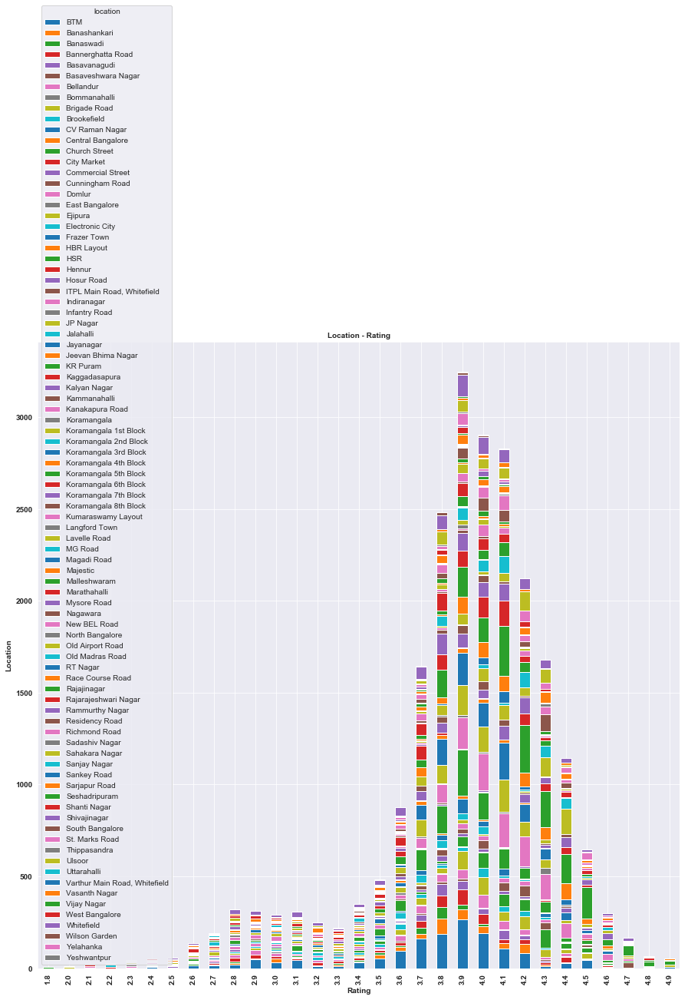

In [15]:
#Location and Rating
type_plt = pd.crosstab(res_data['rate'],res_data['location'])
type_plt.plot(kind='bar',stacked=True, figsize=(15,15));
plt.title('Location - Rating',fontsize=10,fontweight='bold')
plt.ylabel('Location',fontsize=10,fontweight='bold')
plt.xlabel('Rating',fontsize=10,fontweight='bold')
plt.xticks(fontsize=10,fontweight='bold')
plt.yticks(fontsize=10,fontweight='bold');

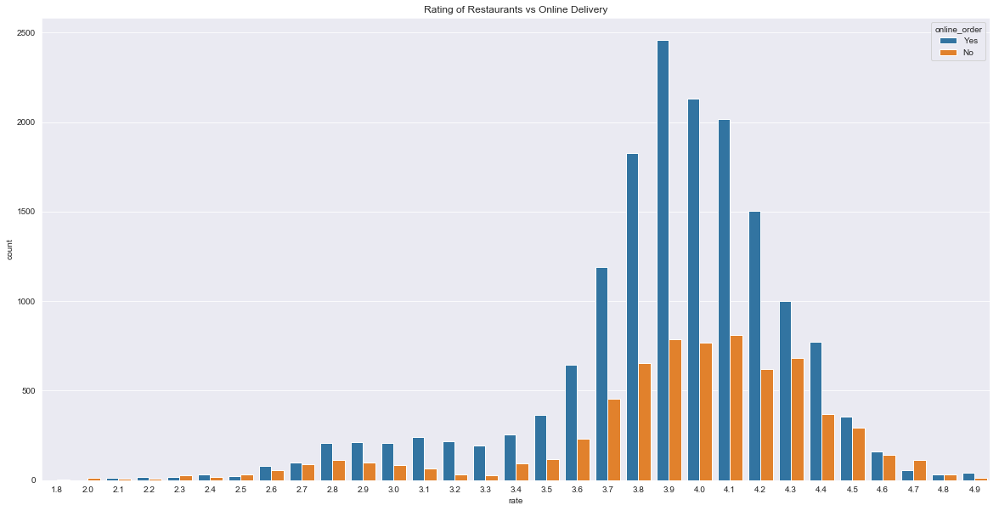

In [16]:
plt.figure(figsize=(20,10))
ax = sns.countplot(x='rate',hue='online_order',data=res_data)
plt.title('Rating of Restaurants vs Online Delivery')
plt.show()

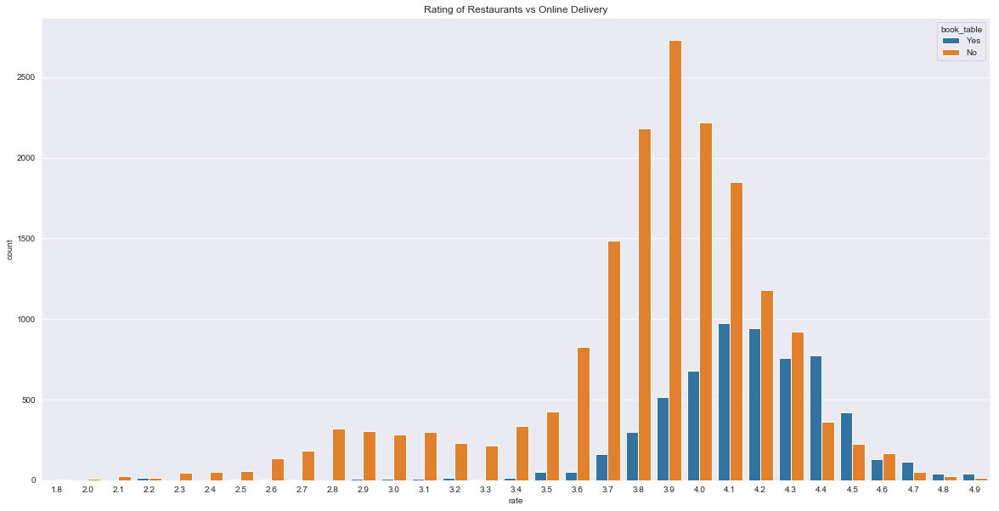

In [17]:
plt.figure(figsize=(20,10))
sns.countplot(x='rate', hue='book_table', data=res_data)
plt.title('Rating of Restaurants vs Online Delivery')
plt.show()

In [18]:
X = res_data
X=X.drop_duplicates(subset='name',keep='first')
newdf=X[['name','cost_for_two_people','location','rest_type','cuisines']].groupby(['cost_for_two_people'], sort = True)
newdf=newdf.filter(lambda x: x.mean() <= 1500)
newdf=newdf.sort_values(by=['cost_for_two_people'])

In [19]:
rate_vote_cost = res_data.copy()
rate_vote_cost = rate_vote_cost.drop_duplicates(subset='name', keep='first')
cheap_res_rate_vote_cost = rate_vote_cost[(rate_vote_cost['rate'] >= 4.5) & 
                                          (rate_vote_cost['cost_for_two_people'] <= 1500) &
                                          (rate_vote_cost['cost_for_two_people'] >= 100) &
                                          (rate_vote_cost['votes'] >= 150)].\
                                          sort_values('cost_for_two_people')

In [20]:
rate_vote_cost_exp = res_data.copy()
rate_vote_cost_exp = rate_vote_cost_exp.drop_duplicates(subset='name', keep='first')
expensive_res_rate_vote_cost = rate_vote_cost_exp[(rate_vote_cost_exp['rate'] >= 4.5) & 
                                              (rate_vote_cost_exp['cost_for_two_people'] >= 3000) & 
                                              (rate_vote_cost_exp['votes'] >= 150)].\
                                              sort_values('cost_for_two_people')

In [21]:
rate_vote_cost_exp = res_data.copy()
rate_vote_cost_exp = rate_vote_cost_exp[rate_vote_cost_exp['cost_for_two_people']>=3000]

Text(0, 0.5, 'Dishes')

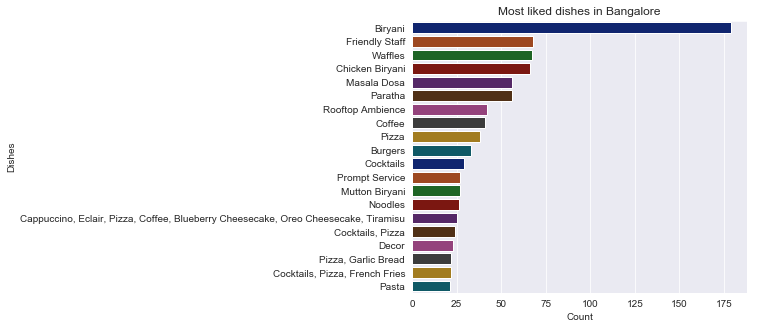

In [22]:
#res_data.dish_liked.value_counts()
most_liked_dishes = res_data.dish_liked.value_counts()[:20]
plt.figure(figsize = (6,5))
sns.set_style('darkgrid')
sns.barplot(x=most_liked_dishes, y=most_liked_dishes.index, palette='dark')
plt.title('Most liked dishes in Bangalore')
plt.xlabel('Count')
plt.ylabel('Dishes')

Text(0, 0.5, 'Name')

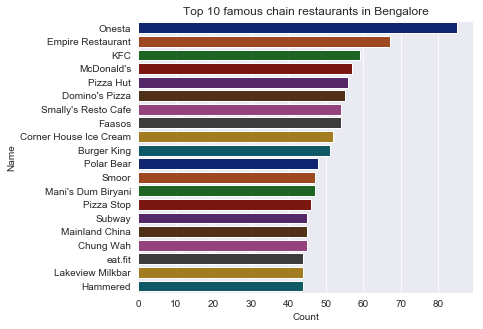

In [23]:
famous_chain = res_data['name'].value_counts()[:20]
plt.figure(figsize=(6,5))
sns.set_style('darkgrid')
sns.barplot(x=famous_chain, y=famous_chain.index, palette='dark')
plt.title('Top 10 famous chain restaurants in Bengalore')
plt.xlabel('Count')
plt.ylabel('Name')

Text(0, 0.5, 'Count')

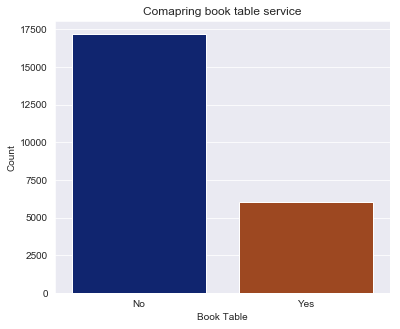

In [24]:
res_book_table = res_data['book_table'].value_counts()
plt.figure(figsize=(6,5))
sns.set_style('darkgrid')
sns.barplot(y=res_book_table, x=res_book_table.index, palette='dark')
plt.title('Comapring book table service')
plt.xlabel('Book Table')
plt.ylabel('Count')

Text(0, 0.5, 'Approximate cost for 2 people')

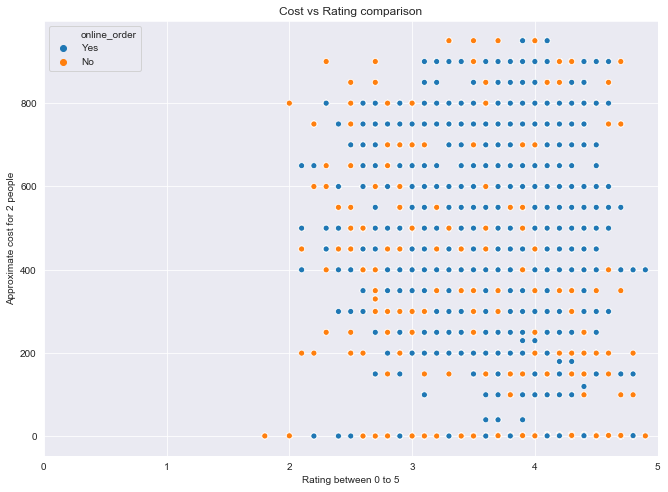

In [25]:
plt.figure(figsize=(11, 8))
sns.set_style('darkgrid')
sns.scatterplot( x='rate', y ='cost_for_two_people', hue='online_order', data=res_data)
plt.title('Cost vs Rating comparison')
plt.xlabel('Rating between 0 to 5')
plt.xlim(0, 5)
plt.ylabel('Approximate cost for 2 people')

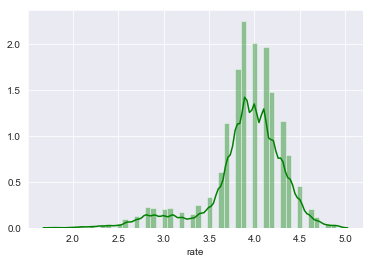

In [26]:
sns.distplot(res_data.rate, bins = 50,  color= 'green')

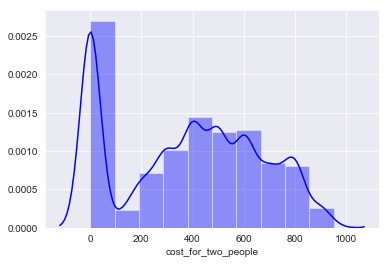

In [27]:
sns.distplot(res_data.cost_for_two_people, bins=10, color='blue')

In [28]:
'''
cuisines = set()
for i in res_data['cuisines']:
    for j in str(i).split(', '):
        cuisines.add(j)

south_indian_res = res_data[res_data['cuisines'].str.contains('South Indian', case=False, regex=True,na=False)]
south_indian_res.head()
'''

"\ncuisines = set()\nfor i in res_data['cuisines']:\n    for j in str(i).split(', '):\n        cuisines.add(j)\n\nsouth_indian_res = res_data[res_data['cuisines'].str.contains('South Indian', case=False, regex=True,na=False)]\nsouth_indian_res.head()\n"

In [29]:
import re
liked_dishes_res = res_data[res_data['dish_liked'].notnull()]
liked_dishes_res.index=range(liked_dishes_res.shape[0])
dishes=[]
for i in range(liked_dishes_res.shape[0]):  
    for item in re.split(',',liked_dishes_res['dish_liked'][i]):
        dishes.append(item)       

Text(0, 0.5, 'Dishes')

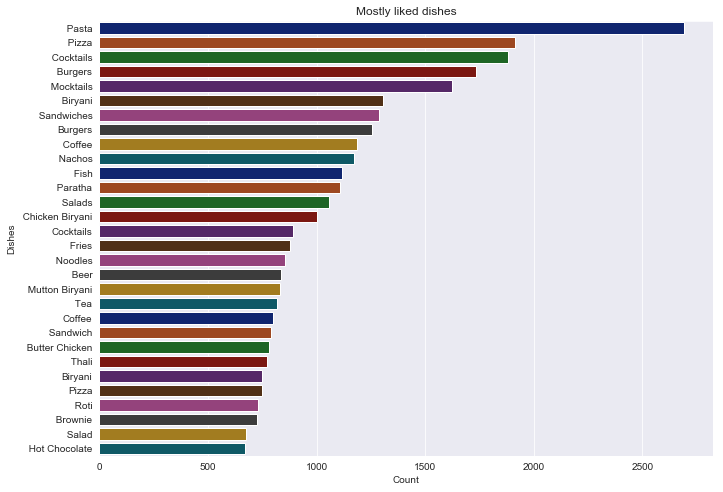

In [30]:
most_liked_dishes = pd.Series(dishes).value_counts()[:30]

plt.figure(figsize=(11, 8))
sns.set_style('darkgrid')
ax = sns.barplot(x=most_liked_dishes, y=most_liked_dishes.index, palette='dark')
plt.title('Mostly liked dishes')
plt.xlabel('Count')
plt.ylabel('Dishes')

In [31]:
res_data.describe()

,rate,votes,cost_for_two_people
count,23248.000000,23248.000000,23248.000000
mean,3.905781,605.461674,380.051215
std,0.426153,1113.706789,280.066849
min,1.800000,0.000000,1.000000
25%,3.800000,104.000000,3.000000
50%,4.000000,225.000000,400.000000
75%,4.200000,597.000000,600.000000
max,4.900000,16832.000000,950.000000


In [32]:
btm_popular_food = res_data.loc[res_data['location']==str('BTM')]

C:\Users\SakhawathHossain\AppData\Local\Continuum\anaconda3\envs\CPU_3.7.5\lib\site-packages\ipykernel_launcher.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  import sys


Text(0, 0.5, 'Dishes')

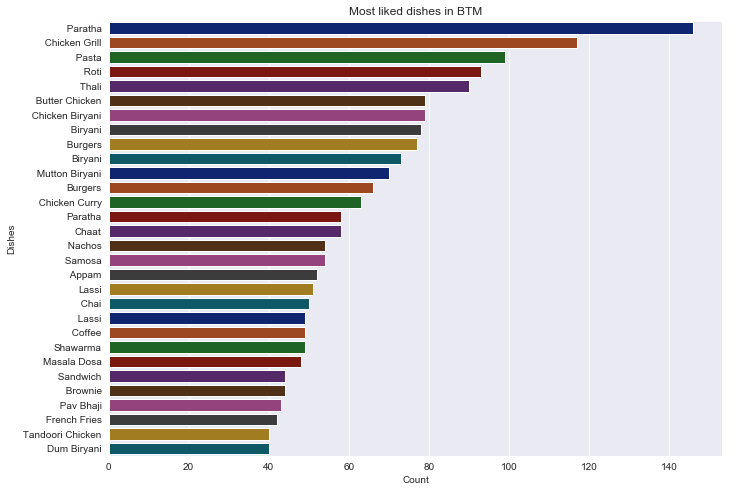

In [33]:
# What kind of food is more popular in a locality?

#btm_popular_food = res_data.loc[res_data['location']==str('BTM')]
#df.loc[a_list]
#df[df.a_col.isnull()]

liked_dishes_btm = btm_popular_food[res_data['dish_liked'].notnull()]
liked_dishes_btm.index = range(liked_dishes_btm.shape[0])

dishes_in_btm = []

for i in range(liked_dishes_btm.shape[0]):  
    for item in re.split(',',liked_dishes_btm['dish_liked'][i]):
        dishes_in_btm.append(item)

        
most_liked_dishes_btm = pd.Series(dishes_in_btm).value_counts()[:30]

plt.figure(figsize=(11, 8))
sns.set_style('darkgrid')
ax = sns.barplot(x=most_liked_dishes_btm, y=most_liked_dishes_btm.index, palette='dark')
plt.title('Most liked dishes in BTM')
plt.xlabel('Count')
plt.ylabel('Dishes')
        

In [34]:
table_trans = res_data.copy() 

table_dict = {'Yes' : '1', 'No' : '-1'} 

table_trans = table_trans.replace({'book_table':table_dict})

table_trans['book_table'] = table_trans['book_table'].astype(float)


online_dict = {'Yes' : '1', 'No' : '-1'} 

online_trans = table_trans.replace({'online_order':online_dict})

online_trans['online_order'] = online_trans['online_order'].astype(float)

In [35]:
top_dishes = 5

for i in range (top_dishes):
    online_trans[most_liked_dishes.index[i]] = 0.0
    
    ind = online_trans['type'].str.contains(most_liked_dishes.index[i])
    
    online_trans[most_liked_dishes.index[i]][ind] = top_dishes - i   

C:\Users\SakhawathHossain\AppData\Local\Continuum\anaconda3\envs\CPU_3.7.5\lib\site-packages\ipykernel_launcher.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  


In [36]:
top_services = 5

for i in range (top_services):
    online_trans[services.index[i]] = 0.0
    
    ind = online_trans['type'].str.contains(services.index[i])
    
    online_trans[services.index[i]][ind] = top_services - i 


C:\Users\SakhawathHossain\AppData\Local\Continuum\anaconda3\envs\CPU_3.7.5\lib\site-packages\ipykernel_launcher.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  


In [37]:
top_cuisines = 5

for i in range (top_cuisines):    
    online_trans[cuisines.index[i]] = 0.0
    
    ind = online_trans['cuisines'].str.contains(cuisines.index[i])
    
    online_trans[cuisines.index[i]][ind] = top_cuisines - i 

C:\Users\SakhawathHossain\AppData\Local\Continuum\anaconda3\envs\CPU_3.7.5\lib\site-packages\ipykernel_launcher.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  


In [38]:
#Mode of the ratings in different area
unique_location = online_trans['location'].unique()

online_trans['location_mode'] = 0.0

for i in range(len(unique_location)):
    ind = online_trans['location']==unique_location[i]
    
    online_trans['location_mode'][ind] = max(online_trans['rate'][ind].mode()) 

C:\Users\SakhawathHossain\AppData\Local\Continuum\anaconda3\envs\CPU_3.7.5\lib\site-packages\ipykernel_launcher.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  if __name__ == '__main__':


In [39]:
#Mean rating of different companies
unique_name = online_trans['name'].unique()

online_trans['name_mean'] = 0.0

for i in range(len(unique_name)):
    ind = online_trans['name']==unique_name[i]
    
    online_trans['name_mean'][ind] = online_trans['rate'][ind].mean()

C:\Users\SakhawathHossain\AppData\Local\Continuum\anaconda3\envs\CPU_3.7.5\lib\site-packages\ipykernel_launcher.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  if __name__ == '__main__':


In [41]:
#import sklearn.preprocessing.MinMaxScaler as minmaxscaler
import sklearn
from sklearn import preprocessing

online_trans['votes'] = sklearn.preprocessing.minmax_scale(online_trans['votes'])
online_trans['votes'] = sklearn.preprocessing.minmax_scale(online_trans['votes'])


In [42]:
online_trans['cost_for_two_people'] = sklearn.preprocessing.minmax_scale(online_trans['cost_for_two_people'])

In [43]:
data_pro = online_trans.copy()

data_pro.drop(["name", "location", "rest_type", "dish_liked", "cuisines"], axis=1, inplace=True)

data_pro.drop(["reviews_list"], axis=1, inplace=True)

data_pro.drop(["menu_item", "type", "city"], axis=1, inplace=True)

data_pro['quality'] = int(0)

In [44]:
data_pro.head()

,online_order,book_table,rate,votes,cost_for_two_people,Pasta,Pizza,Cocktails,Burgers,Mocktails,...,Cafes,Drinks & nightlife,North Indian,"North Indian, Chinese",South Indian,Cafe,"South Indian, North Indian, Chinese",location_mode,name_mean,quality
0,1.0,1.0,4.1,0.046043,0.841939,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,5.0,0.0,0.0,0.0,0.0,3.8,4.118182,0
1,1.0,-1.0,4.1,0.046756,0.841939,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,5.0,0.0,0.0,0.0,0.0,3.8,4.100000,0
2,1.0,-1.0,3.8,0.054539,0.841939,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,2.0,0.0,3.8,3.800000,0
3,-1.0,-1.0,3.7,0.005228,0.315068,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,5.0,0.0,3.0,0.0,0.0,3.8,3.700000,0
4,-1.0,-1.0,3.8,0.009862,0.631191,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,5.0,0.0,0.0,0.0,0.0,3.8,3.800000,0


In [45]:
ind = data_pro['rate'] < 3.7
data_pro['quality'][ind] = int(3)

ind = data_pro['rate'] >= 3.7
data_pro['quality'][ind] = int(2)

ind = data_pro['rate'] >= 4.2
data_pro['quality'][ind] = int(1)

ind = data_pro['rate'] > data_pro['location_mode']
data_pro['quality'][ind] = int(1)

C:\Users\SakhawathHossain\AppData\Local\Continuum\anaconda3\envs\CPU_3.7.5\lib\site-packages\ipykernel_launcher.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  
C:\Users\SakhawathHossain\AppData\Local\Continuum\anaconda3\envs\CPU_3.7.5\lib\site-packages\ipykernel_launcher.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  """
C:\Users\SakhawathHossain\AppData\Local\Continuum\anaconda3\envs\CPU_3.7.5\lib\site-packages\ipykernel_launcher.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-

In [46]:
data_pro.to_csv (r'C:\Users\SakhawathHossain\Desktop\Codetest\workspace_bangalore_restaurants\data\data_pro.csv',\
                 index=None, header=True)

In [66]:
data_pro.drop(['rate'], axis=1, inplace=True)

In [82]:
X = data_pro.iloc[:, 0:21].values
y = data_pro.iloc[:, 21].values

In [110]:
from sklearn.model_selection import train_test_split
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.25, random_state=0)

from sklearn.preprocessing import StandardScaler
sc_X = StandardScaler()
X_train = sc_X.fit_transform(X_train)
X_test = sc_X.transform(X_test)

from sklearn.tree import DecisionTreeClassifier
classifier = DecisionTreeClassifier()
classifier = classifier.fit(X_train, y_train)

#prediction
y_pred = classifier.predict(X_test)
#Accuracy
from sklearn import metrics
print('Accuracy Score:', metrics.accuracy_score(y_test, y_pred)*100, '%')

Accuracy Score: 97.5223675154852 %


In [91]:
from sklearn.metrics import confusion_matrix
cm = confusion_matrix(y_test, y_pred)
cm

In [92]:
cm

array([[2201,   31,    5],
       [  38, 2509,   24],
       [   4,   48,  952]], dtype=int64)

In [224]:
%pip install pydotplus

Note: you may need to restart the kernel to use updated packages.


In [225]:
%conda install python-graphviz

Solving environment: ...working... done

# All requested packages already installed.


Note: you may need to restart the kernel to use updated packages.




==> WARNING: A newer version of conda exists. <==
  current version: 4.8.0
  latest version: 4.8.1

Please update conda by running

    $ conda update -n base -c defaults conda




In [232]:
#feature_cols = 
#feature_cols = ['Age','EstimatedSalary' ]

feature_cols = ['online_order', 'book_table', 'votes', 'cost_for_two_people', ' Pasta',
       ' Pizza', ' Cocktails', ' Burgers', ' Mocktails', 'Delivery',
       'Dine-out', 'Desserts', 'Cafes', 'Drinks & nightlife', 'North Indian',
       'North Indian, Chinese', 'South Indian', 'Cafe',
       'South Indian, North Indian, Chinese', 'location_mode', 'name_mean']


In [233]:
from sklearn.tree import export_graphviz
from sklearn.externals.six import StringIO  
from IPython.display import Image  
import pydotplus

dot_data = StringIO()
export_graphviz(classifier, out_file=dot_data,  
                filled=True, rounded=True,
                special_characters=True,feature_names = feature_cols,class_names=['1','2', '3'])
graph = pydotplus.graph_from_dot_data(dot_data.getvalue())  
Image(graph.create_png())

InvocationException: GraphViz's executables not found

In [131]:
from numpy import loadtxt
from keras.models import Sequential
from keras.layers import Dense
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler


# split into input (X) and output (y) variables
X = data_pro.iloc[:, 0:21].values
y = data_pro.iloc[:, 21].values

sc_X = StandardScaler()
X_train = sc_X.fit_transform(X_train)
X_test = sc_X.transform(X_test)

In [138]:
# encode class values as integers
encoder = LabelEncoder()
encoder.fit(y)
encoded_Y = encoder.transform(y)

# one hot encoded
one_hot_y = np_utils.to_categorical(encoded_Y)

X_train, X_test, y_train, y_test = train_test_split(X, one_hot_y, test_size=0.25, random_state=0)

In [218]:
# define the keras model
model = Sequential()

# define the keras model
model.add(Dense(84, input_dim=21, activation='relu'))
model.add(Dense(42, activation='relu'))
model.add(Dense(21, activation='relu'))
model.add(Dense(3, activation='softmax'))

# compile the keras model
model.compile(loss='binary_crossentropy', optimizer='adam', metrics=['accuracy'])

# fit the keras model on the dataset
model.fit(X_train, y_train, epochs=15, batch_size=100)

Epoch 1/15
17436/17436 [==============================] - 1s 83us/step - loss: 0.5094 - acc: 0.7282
Epoch 2/15
17436/17436 [==============================] - 0s 21us/step - loss: 0.3485 - acc: 0.8500
Epoch 3/15
17436/17436 [==============================] - 0s 20us/step - loss: 0.2841 - acc: 0.8801
Epoch 4/15
17436/17436 [==============================] - 0s 20us/step - loss: 0.2676 - acc: 0.8877
Epoch 5/15
17436/17436 [==============================] - ETA: 0s - loss: 0.2637 - acc: 0.887 - 0s 20us/step - loss: 0.2619 - acc: 0.8884
Epoch 6/15
17436/17436 [==============================] - 0s 20us/step - loss: 0.2504 - acc: 0.8954
Epoch 7/15
17436/17436 [==============================] - 1s 32us/step - loss: 0.2514 - acc: 0.8935
Epoch 8/15
17436/17436 [==============================] - 1s 30us/step - loss: 0.2475 - acc: 0.8958
Epoch 9/15
17436/17436 [==============================] - 0s 19us/step - loss: 0.2433 - acc: 0.8975
Epoch 10/15
17436/17436 [==============================] - 0s 

In [162]:
# evaluate the keras model
_, accuracy = model.evaluate(X_test, y_test)
print('Accuracy: %.2f' % (accuracy*100))

5812/5812 [==============================] - 1s 86us/step
Accuracy: 95.76


In [166]:
predictions = model.predict(X_test)

matrix = metrics.confusion_matrix(y_test.argmax(axis=1), predictions.argmax(axis=1))

matrix

In [221]:
import xgboost
import shap

# load JS visualization code to notebook
shap.initjs()

# train XGBoost model
#X,y = shap.datasets.boston()
model = xgboost.train({"learning_rate": 0.01}, xgboost.DMatrix(X_train, label=y_train), 100)

In [222]:
# explain the model's predictions using SHAP
# (same syntax works for LightGBM, CatBoost, scikit-learn and spark models)
explainer = shap.TreeExplainer(model)
shap_values = explainer.shap_values(X_train)

# visualize the first prediction's explanation (use matplotlib=True to avoid Javascript)
shap.force_plot(explainer.expected_value, shap_values[0,:], X_test[0,:])

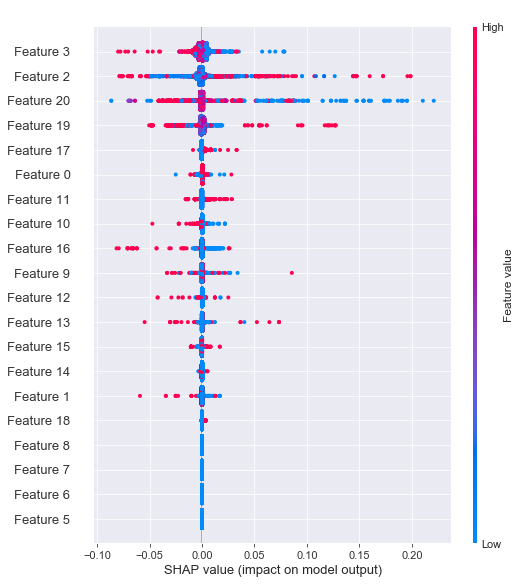

In [223]:
# summarize the effects of all the features
shap.summary_plot(shap_values, X_train)

In [216]:
data_pro.columns[3]

'cost_for_two_people'

In [217]:
# visualize the training set predictions
shap.force_plot(explainer.expected_value, shap_values, X_train)

shap.force_plot is slow for many thousands of rows, try subsampling your data.


In [121]:
# multi-class classification with Keras
import pandas
from keras.models import Sequential
from keras.layers import Dense
from keras.wrappers.scikit_learn import KerasClassifier
from keras.utils import np_utils
from sklearn.model_selection import cross_val_score
from sklearn.model_selection import KFold
from sklearn.preprocessing import LabelEncoder
from sklearn.pipeline import Pipeline

# load dataset
#dataframe = pandas.read_csv("iris.data", header=None)
#dataset = dataframe.values

# split into input (X) and output (y) variables
X = data_pro.iloc[:, 0:21].values
y = data_pro.iloc[:, 21].values

# encode class values as integers
encoder = LabelEncoder()
encoder.fit(y)
encoded_Y = encoder.transform(y)

# convert integers to dummy variables (i.e. one hot encoded)
dummy_y = np_utils.to_categorical(encoded_Y)
 
# define baseline model
def baseline_model():
    # create model
    model.add(Dense(42, input_dim=21, activation='relu'))
    model.add(Dense(21, activation='relu'))
    model.add(Dense(1, activation='softmax'))
    # Compile model
    model.compile(loss='categorical_crossentropy', optimizer='adam', metrics=['accuracy'])
    return model
 
estimator = KerasClassifier(build_fn=baseline_model, epochs=200, batch_size=5, verbose=0)
kfold = KFold(n_splits=10, shuffle=True)
results = cross_val_score(estimator, X, dummy_y, cv=kfold)
print("Baseline: %.2f%% (%.2f%%)" % (results.mean()*100, results.std()*100))

C:\Users\SakhawathHossain\AppData\Local\Continuum\anaconda3\envs\CPU_3.7.5\lib\site-packages\sklearn\model_selection\_validation.py:536: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
ValueError: Error when checking target: expected dense_15 to have shape (1,) but got array with shape (3,)

  FitFailedWarning)
C:\Users\SakhawathHossain\AppData\Local\Continuum\anaconda3\envs\CPU_3.7.5\lib\site-packages\sklearn\model_selection\_validation.py:536: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
ValueError: Error when checking target: expected dense_18 to have shape (1,) but got array with shape (3,)

  FitFailedWarning)
C:\Users\SakhawathHossain\AppData\Local\Continuum\anaconda3\envs\CPU_3.7.5\lib\site-packages\sklearn\model_selection\_validation.py:536: FitFailedWarning: Estimator fit failed. The score on this train-test part

Baseline: nan% (nan%)


C:\Users\SakhawathHossain\AppData\Local\Continuum\anaconda3\envs\CPU_3.7.5\lib\site-packages\sklearn\model_selection\_validation.py:536: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
ValueError: Error when checking target: expected dense_36 to have shape (1,) but got array with shape (3,)

  FitFailedWarning)
C:\Users\SakhawathHossain\AppData\Local\Continuum\anaconda3\envs\CPU_3.7.5\lib\site-packages\sklearn\model_selection\_validation.py:536: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
ValueError: Error when checking target: expected dense_39 to have shape (1,) but got array with shape (3,)

  FitFailedWarning)
C:\Users\SakhawathHossain\AppData\Local\Continuum\anaconda3\envs\CPU_3.7.5\lib\site-packages\sklearn\model_selection\_validation.py:536: FitFailedWarning: Estimator fit failed. The score on this train-test part

In [ ]:
from matplotlib.colors import ListedColormap
X_set, y_set = X_test, y_test
X1, X2 = np.meshgrid(np.arange(start = X_set[:,0].min()-1, stop= X_set[:,0].max()+1, step = 0.01),np.arange(start = X_set[:,1].min()-1, stop= X_set[:,1].max()+1, step = 0.01))
plt.contourf(X1,X2, classifier.predict(np.array([X1.ravel(), X2.ravel()]).T).reshape(X1.shape), alpha=0.75, cmap = ListedColormap(("red","green")))
plt.xlim(X1.min(), X1.max())
plt.ylim(X2.min(), X2.max())
for i,j in enumerate(np.unique(y_set)):
    plt.scatter(X_set[y_set==j,0],X_set[y_set==j,1], c = ListedColormap(("red","green"))(i),label = j)
plt.title("Decision Tree(Test set)")
plt.xlabel("Age")
plt.ylabel("Estimated Salary")
plt.legend()
plt.show()

In [52]:
conda install python-graphviz

Solving environment: ...working... done

# All requested packages already installed.


Note: you may need to restart the kernel to use updated packages.




==> WARNING: A newer version of conda exists. <==
  current version: 4.8.0
  latest version: 4.8.1

Please update conda by running

    $ conda update -n base -c defaults conda




In [53]:
pip install pydotplus

Note: you may need to restart the kernel to use updated packages.


In [64]:
from sklearn.tree import export_graphviz
from sklearn.externals.six import StringIO  
from IPython.display import Image  
import pydotplus
dot_data = StringIO()
export_graphviz(classifier, out_file=dot_data,  
                filled=True, rounded=True,
                special_characters=True,feature_names = feature_cols,class_names=['0','1'])
graph = pydotplus.graph_from_dot_data(dot_data.getvalue())  
Image(graph.create_png())

C:\Users\SakhawathHossain\AppData\Local\Continuum\anaconda3\envs\CPU_3.7.5\lib\site-packages\sklearn\externals\six.py:31: FutureWarning: The module is deprecated in version 0.21 and will be removed in version 0.23 since we've dropped support for Python 2.7. Please rely on the official version of six (https://pypi.org/project/six/).
  "(https://pypi.org/project/six/).", FutureWarning)


NameError: name 'feature_cols' is not defined